In [ ]:
import os
import numpy as np
import cv2, os
from google.colab.patches import cv2_imshow
from google.colab import files, drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


Небольшая тестовая выборка

In [ ]:
!cp '/content/drive/MyDrive/ForColab/asian-detect.rar' '/content'
!unrar x /content/asian-detect.rar /content/


UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from /content/asian-detect.rar

Creating    /content/asian-detect                                     OK
Creating    /content/asian-detect/asian                               OK
Extracting  /content/asian-detect/asian/1014.png                           4%  OK 
Extracting  /content/asian-detect/asian/1075.png                           8%  9%  OK 
Extracting  /content/asian-detect/asian/1091.png                          13% 14%  OK 
Extracting  /content/asian-detect/asian/118.png                           18%  OK 
Extracting  /content/asian-detect/asian/121.png                           22% 23%  OK 
Extracting  /content/asian-detect/asian/123.png                           27% 28%  OK 
Extracting  /content/asian-detect/asian/130.png                           32% 33%  OK 
Extracting  /content/asian-detect/asian/135.png    

Основная полная выборка

In [ ]:
!rm /content/asian-not-asian.rar
!rm -r /content/asian-not-asian/
!cp '/content/drive/MyDrive/ForColab/asian-not-asian.rar' '/content'
!unrar x /content/asian-not-asian.rar /content/

rm: cannot remove '/content/asian-not-asian.rar': No such file or directory
rm: cannot remove '/content/asian-not-asian/': No such file or directory

UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from /content/asian-not-asian.rar

Creating    /content/asian-not-asian                                  OK
Creating    /content/asian-not-asian/asian                            OK
Extracting  /content/asian-not-asian/asian/1000.png                        0%  OK 
Extracting  /content/asian-not-asian/asian/1001.png                        0%  OK 
Extracting  /content/asian-not-asian/asian/1003.png                        0%  OK 
Extracting  /content/asian-not-asian/asian/1004.png                        0%  OK 
Extracting  /content/asian-not-asian/asian/1005.png                        1%  OK 
Extracting  /content/asian-not-asian/asian/1006.png                        1%  OK 
Extracting  /content/asian-not-

In [ ]:
!cp '/content/drive/MyDrive/ForColab/metrics.txt' '/content'
!cp '/content/drive/MyDrive/ForColab/labels.txt' '/content'

In [ ]:
files.upload()
!mkdir test_photo

Saving 0 (12).png to 0 (12).png
Saving 0 (65).jpg to 0 (65).jpg
Saving 1 (700).jpg to 1 (700).jpg
Saving kitaec.jpg to kitaec.jpg
mv: cannot stat '*.jpg,': No such file or directory
mv: '0 (12).png' and '/content/0 (12).png' are the same file


In [ ]:
!git clone https://github.com/opencv/opencv.git
!cp /content/opencv/data/haarcascades/haarcascade_eye.xml /content
!cp /content/opencv/data/haarcascades/haarcascade_frontalface_default.xml /content

Cloning into 'opencv'...
remote: Enumerating objects: 342796, done.
remote: Counting objects: 100% (461/461), done.
remote: Compressing objects: 100% (268/268), done.
remote: Total 342796 (delta 339), reused 193 (delta 193), pack-reused 342335 (from 4)
Receiving objects: 100% (342796/342796), 532.42 MiB | 24.13 MiB/s, done.
Resolving deltas: 100% (239002/239002), done.
Updating files: 100% (7597/7597), done.


In [ ]:
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('haarcascade_eye.xml')

In [ ]:
class DetectFace():
  def __init__(self):
    self.__metrics = np.array([], dtype=np.float64)
    self.__labels = np.array([], dtype=int)

  def fit(self, dir, label, show_image=False):
    files = os.listdir(dir)

    for file in files:
      metrics = self.find_face(dir + file, show_image)
      self.__metrics = np.append(self.__metrics, metrics)
      self.__labels = np.append(self.__labels, [label] * metrics.size)

  def find_face(self, path, show_image, debug=False):
    image = cv2.imread(path)
    self.__image = image
    self.__debug = debug
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # обнаружение лиц на изображении
    faces = face_cascade.detectMultiScale(gray, 1.1, 4)
    metrics = np.array([])
    for face in faces:
      (x, y, w, h) = face
      # получаем область лица
      face_roi = gray[y:y+h, x:x+w]

      # ищем глаза в области лица
      eyes = eye_cascade.detectMultiScale(face_roi)

      if len(eyes) == 0:
        continue

      if show_image:
        self.draw_image(image, face, eyes)

      # если мы смотрим по особенностям века глаза
      self.__eye_image = self.select_object(face, eyes[0]) # предполагаем, что первый найденный объект = глаз, им и занимаемся дальше

      self.__eye_image = cv2.cvtColor(self.__eye_image, cv2.COLOR_BGR2GRAY)
      ret, thresh  = cv2.threshold(self.__eye_image, 120, 255, cv2.THRESH_BINARY) # преобразования изображения в бинарное
      if self.__debug:
        cv2_imshow(thresh)

      metrics = self.calculate_rows_of_skin_to_eye(thresh) / h # количество найденных строк делим высоту изображения

    return metrics

  def select_object(self, face, eye):
    (x, y, w, h) = face
    (ox, oy, ow, oh) = eye
    return self.__image[y + oy:y + oy + oh, x + ox:x + ox + ow]

  def draw_image(self, image, face, objects):
    (x, y, w, h) = face
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    if objects is not None:
        for (ox, oy, ow, oh) in objects:
          cv2.rectangle(image, (x + ox, y + oy), (x + ox + ow, y + oy + oh), (255, 0, 0), 2)

    if image.shape[0] > 1000 or image.shape[1] > 1000:
      image = cv2.resize(image, dsize=(500, 500))

    cv2_imshow(image)
    cv2.waitKey(0)

  def calculate_rows_of_skin_to_eye(self, image):
    image = image[:image.shape[0] // 2][:] # считаем, что середина глаза = середина изображение, поэтому рассматриваем только верхнюю часть
    blues_count = np.array([], dtype='int')
    for row in image:
      unique, counts = np.unique(row, return_counts=True)
      color_counts = dict(zip(unique, counts))
      blues_count = np.append(blues_count, color_counts[255] if 255 in unique else 0)

    light_rows_count = len(blues_count[blues_count > blues_count.size * 0.66]) # считаем, что строка светлая при условии, что белых пикселей > 66%
    if self.__debug:
        print(f'Количество строк, в которых преобладает белый цвет: {blues_count[-1]}')

    return light_rows_count

  def get_metrics(self):
    return self.__metrics.reshape(-1, 1)

  def get_labels(self):
    return self.__labels.reshape(-1, 1)

  def save_data(self):
    with open('metrics.txt', 'w') as f:
      for metric in self.__metrics:
        f.write(f"{metric}\n")

    with open('labels.txt', 'w') as f:
      for label in self.__labels:
        f.write(f"{label}\n")

  def load_data(self, metrics_path, labels_path):
    metrics = []
    labels = []
    with open(metrics_path, 'r') as f:
      lines = [line.rstrip() for line in f]
      for line in lines:
        metrics.append(line)
    self.__metrics = np.array(metrics)

    with open(labels_path, 'r') as f:
      lines = [line.rstrip() for line in f]
      for line in lines:
        labels.append(int(float(line)))

    self.__labels = np.array(labels)

  def clear_arrays(self):
    self.__labels = np.array([])
    self.__metrics = np.array([])

In [ ]:
detectFace = DetectFace()

In [ ]:
detectFace.load_data('/content/metrics.txt', '/content/labels.txt')

In [ ]:
detectFace.find_face('/content/test_photo/1 (700).jpg', False)

error: OpenCV(4.11.0) /io/opencv/modules/imgproc/src/color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [ ]:
detectFace.find_face('/content/test_photo/0 (65).jpg', False)


error: OpenCV(4.11.0) /io/opencv/modules/imgproc/src/color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


[418  90 193 193]


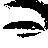

0.09844559585492228
19.0
[451 480  64  64]


array([], dtype=float64)

In [ ]:
detectFace.find_face('/content/test_photo/kitaec.jpg', False)

shape image: (2361, 2126, 3)


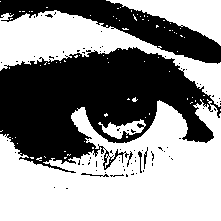

62


array([], dtype=float64)

In [ ]:
detectFace.find_face('/content/test_photo/0 (12).png', False)

# Тест алгоритма на небольшой выборке

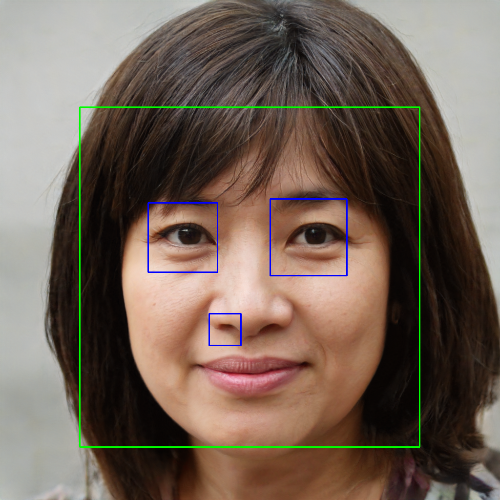

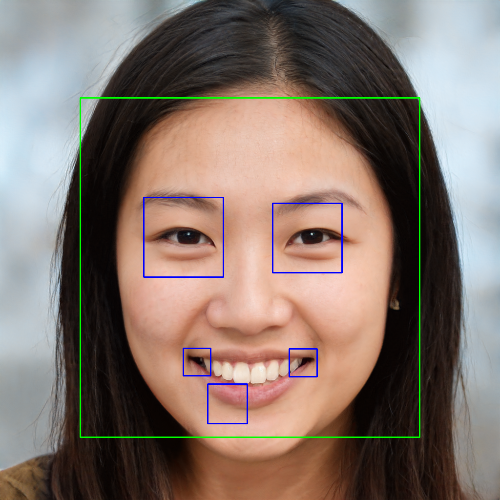

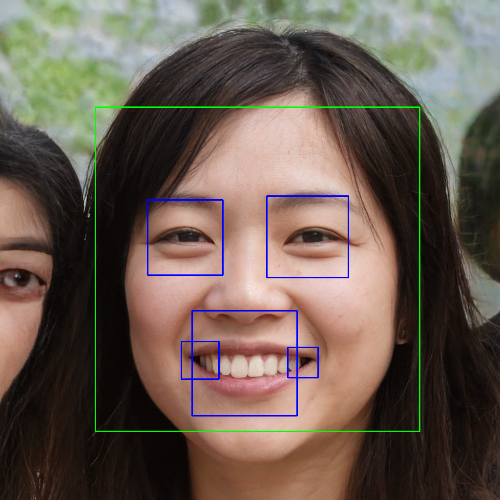

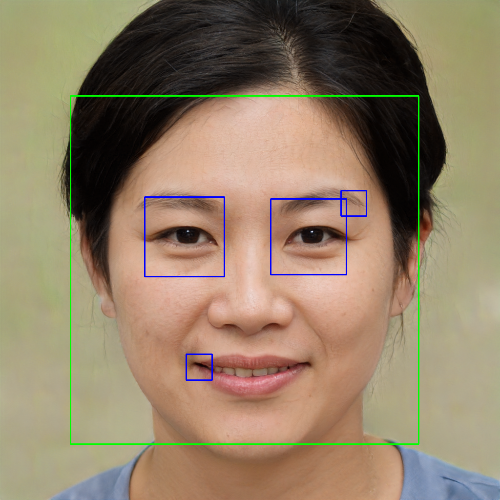

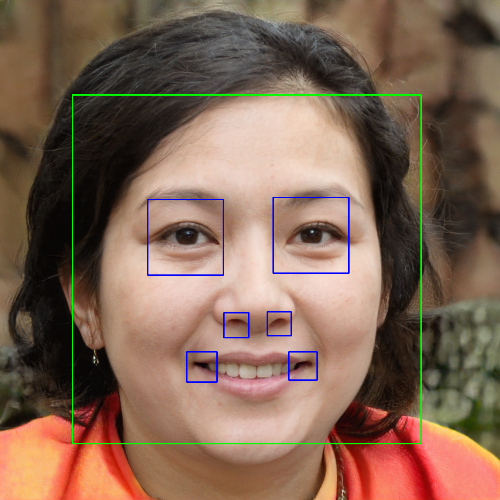

...

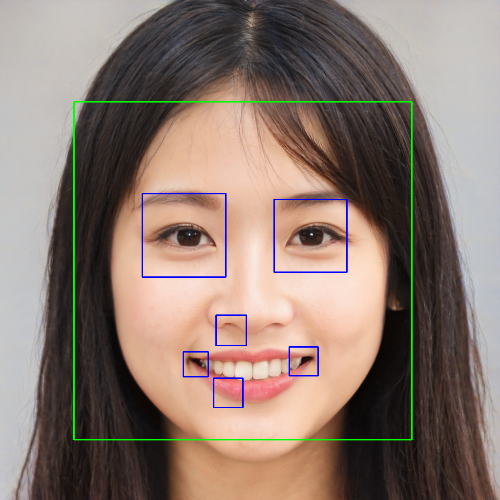

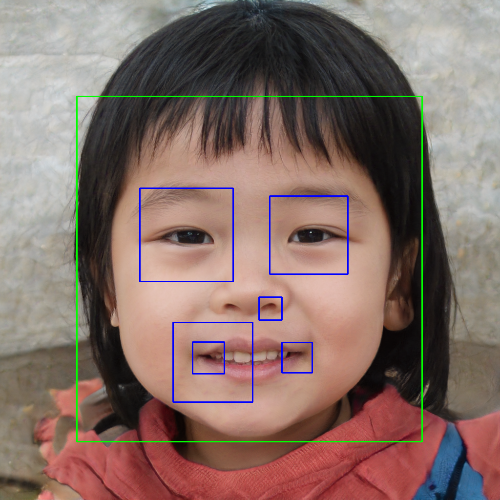

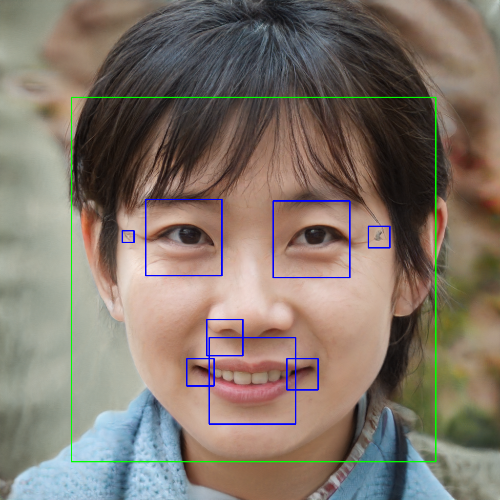

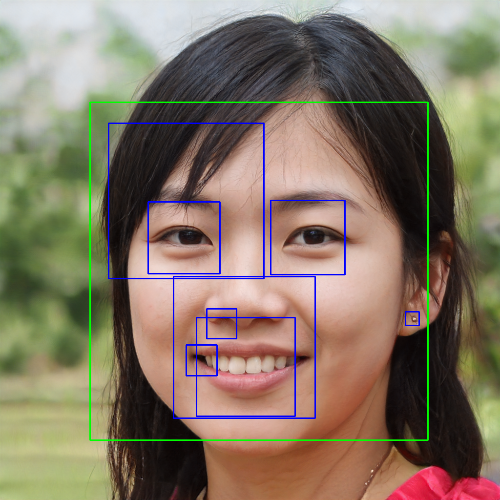

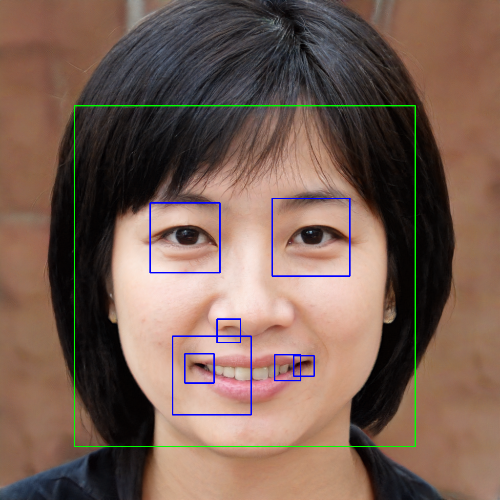

In [ ]:
detectFace.fit('/content/asian-detect/asian/', 0, True)

In [ ]:
detectFace.fit('/content/asian-detect/not-asian/', 1, False)

current file: 0 (40).png


KeyboardInterrupt: 

# Обучение на основной выборке

In [ ]:
detectFace.fit('/content/asian-not-asian/asian/', 0, False)

In [ ]:
detectFace.fit('/content/asian-not-asian/not-asian/', 1, False)

In [ ]:
detectFace.save_data()

In [ ]:
!cp /content/labels.txt /content/drive/MyDrive/ForColab/
!cp /content/metrics.txt /content/drive/MyDrive/ForColab/

# Применение метода опорных векторов для классификации лиц

In [ ]:
from sklearn import svm

In [ ]:
X = detectFace.get_metrics()
y = detectFace.get_labels()
clf = svm.SVC()
clf.fit(X, y)

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC()

In [ ]:
files.upload()

Saving Putin.jpg to Putin.jpg


{'Putin.jpg': b'\xff\xd8\xff\xdb\x00C\x00\x04\x03\x03\x04\x03\x03\x04\x04\x03\x04\x05\x04\x04\x05\x06\n\x07\x06\x06\x06\x06\r\t\n\x08\n\x0f\r\x10\x10\x0f\r\x0f\x0e\x11\x13\x18\x14\x11\x12\x17\x12\x0e\x0f\x15\x1c\x15\x17\x19\x19\x1b\x1b\x1b\x10\x14\x1d\x1f\x1d\x1a\x1f\x18\x1a\x1b\x1a\xff\xdb\x00C\x01\x04\x05\x05\x06\x05\x06\x0c\x07\x07\x0c\x1a\x11\x0f\x11\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\x1a\xff\xc0\x00\x11\x08\x03U\x02\x80\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1d\x00\x00\x02\x02\x03\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x04\x03\x05\x06\x07\x08\t\xff\xc4\x00E\x10\x00\x01\x03\x03\x03\x02\x05\x02\x04\x05\x03\x03\x03\x03\x01\t\x01\x00\x02\x11\x03\x04!\x05\x121AQ\x06\x13"aq\x07\x81\x142\x91\xa1\x08#B\xb1\xc1\x15R\xd13b\xe1$\xf0\xf1\x16Cr\x924\x17\x82\xa2STcs\xb2\xff\xc4\x00\x1b\x01\x00\x03\x01\x01

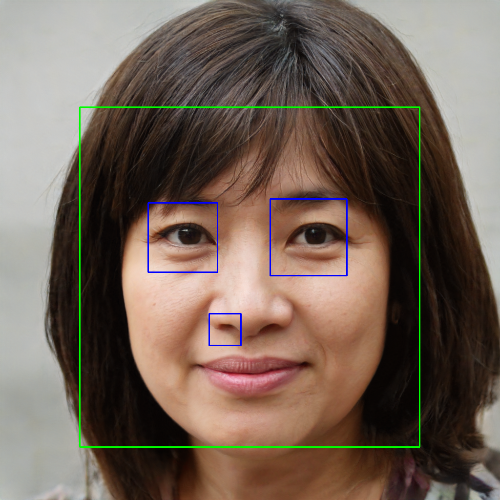

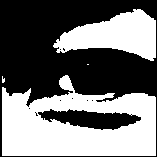

Количество строк, в которых преобладает белый цвет: 8
1


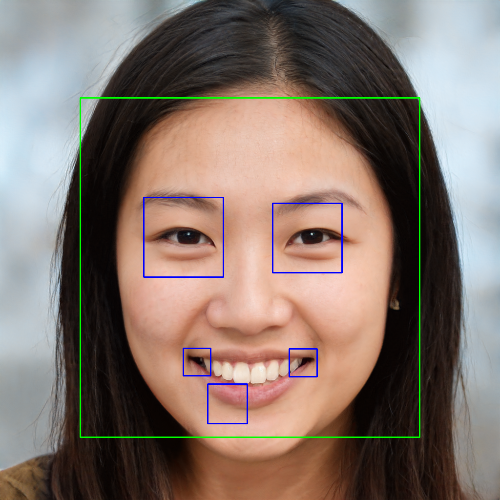

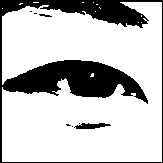

Количество строк, в которых преобладает белый цвет: 37
0


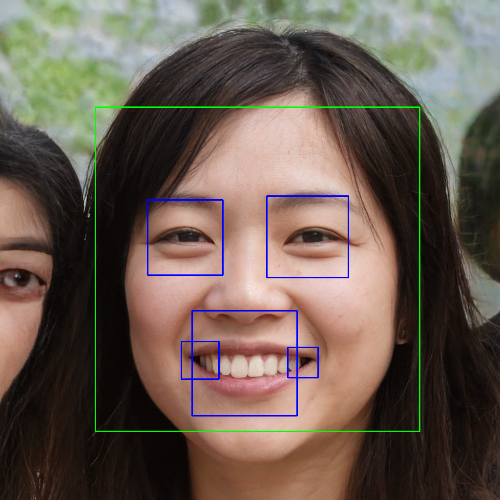

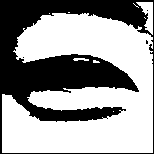

Количество строк, в которых преобладает белый цвет: 24
0


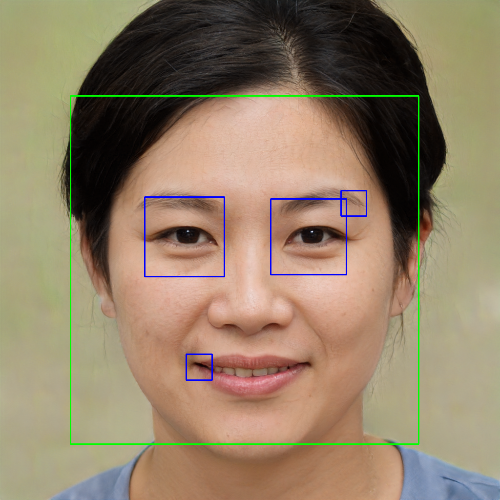

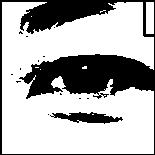

Количество строк, в которых преобладает белый цвет: 26
0


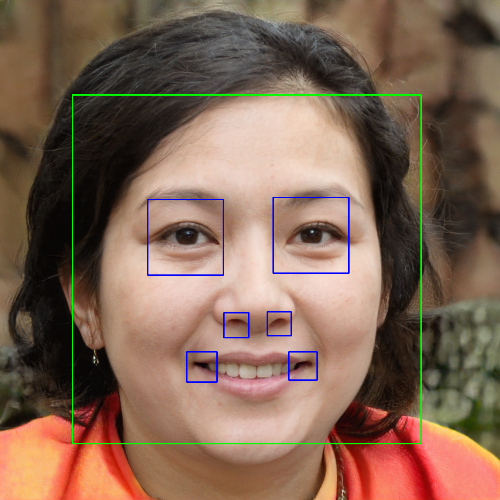

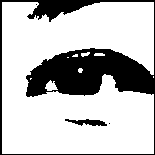

Количество строк, в которых преобладает белый цвет: 36
0


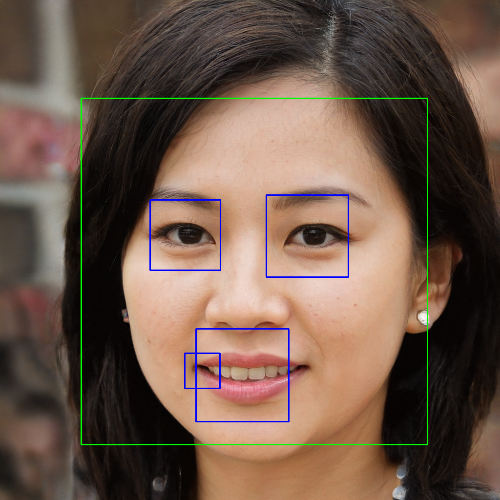

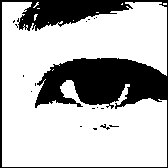

Количество строк, в которых преобладает белый цвет: 47
0


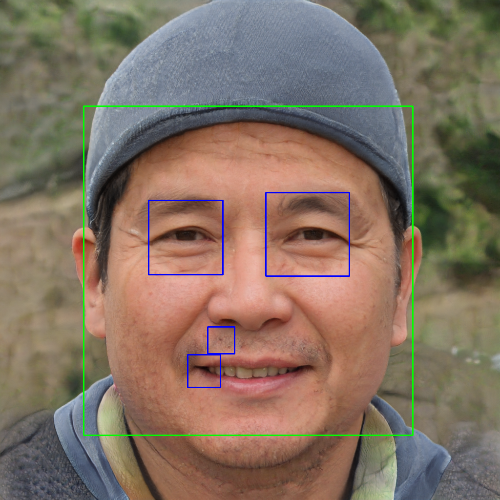

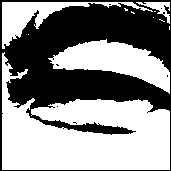

Количество строк, в которых преобладает белый цвет: 22
0


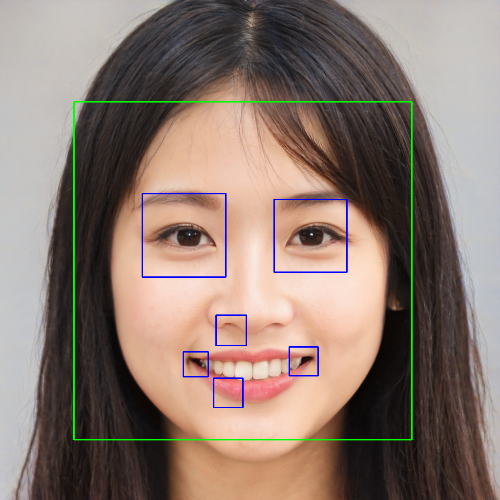

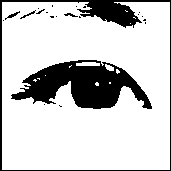

Количество строк, в которых преобладает белый цвет: 68
0


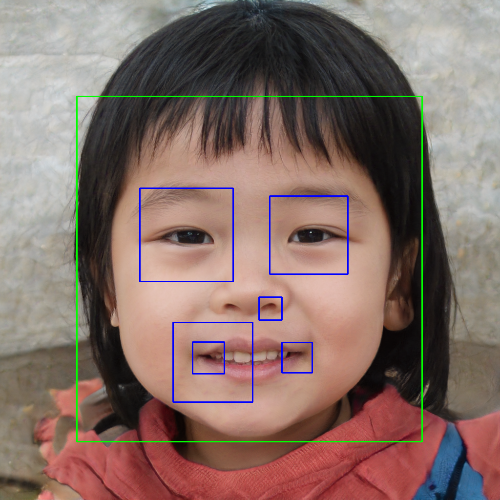

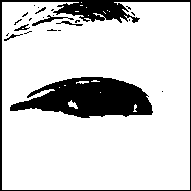

Количество строк, в которых преобладает белый цвет: 80
0


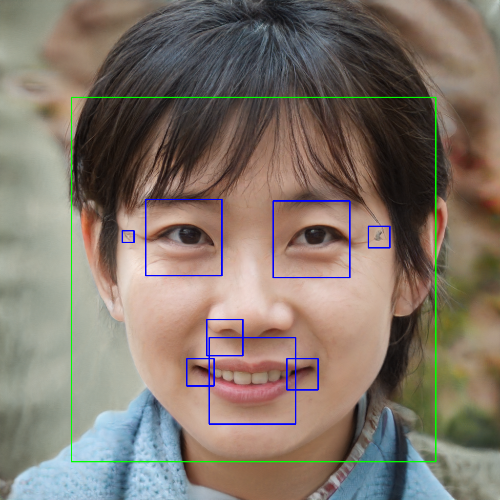

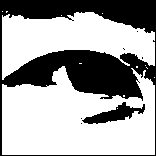

Количество строк, в которых преобладает белый цвет: 26
1


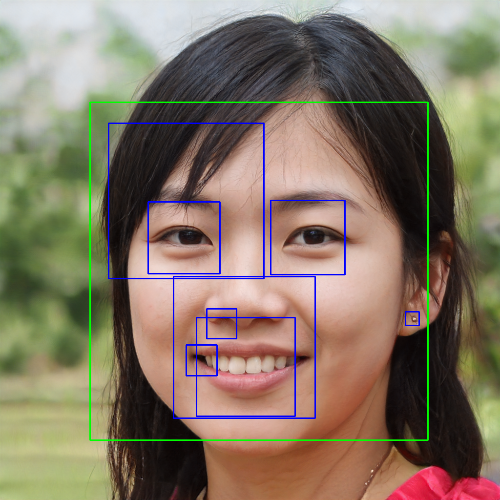

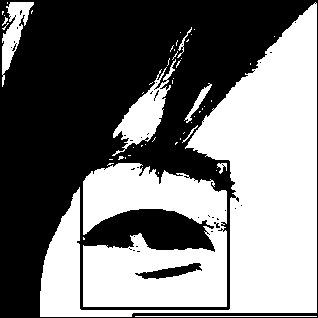

Количество строк, в которых преобладает белый цвет: 110
0


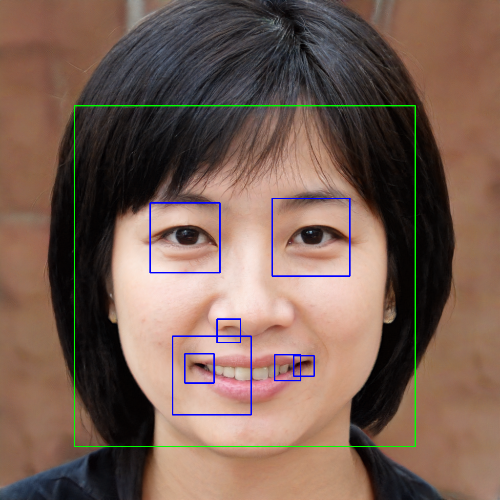

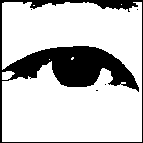

Количество строк, в которых преобладает белый цвет: 35
0
Точность модели:  83.33%.


In [ ]:
dir = '/content/asian-detect/asian/'
files = os.listdir(dir)

images_class = 0
image_count = len(files)
successful_predictions = 0

for file in files:
  metrics = detectFace.find_face(dir + file, show_image=True, debug=True)
  predict = clf.predict(metrics.reshape(-1, 1))
  if images_class == predict[0]:
    successful_predictions += 1
  print(predict[0])

print(f'Точность модели: {successful_predictions / image_count * 100: .2f}%.')

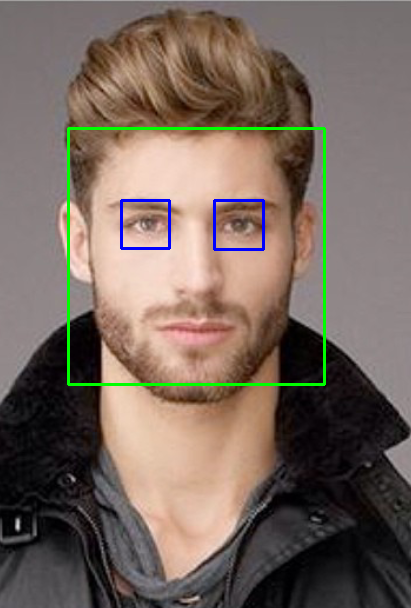

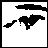

Количество строк, в которых преобладает белый цвет: 27


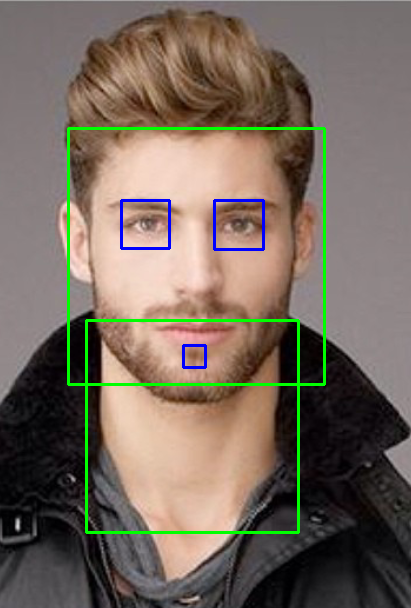

Количество строк, в которых преобладает белый цвет: 8
1


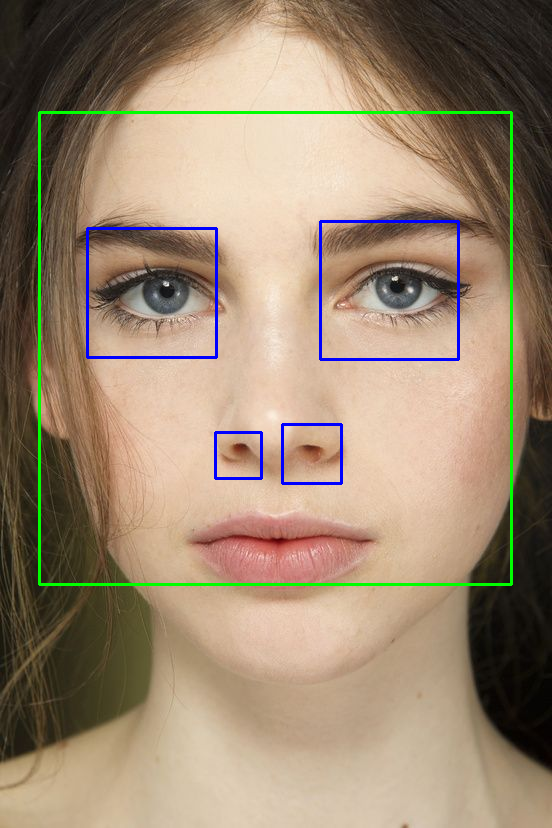

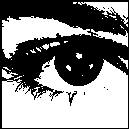

Количество строк, в которых преобладает белый цвет: 19
1


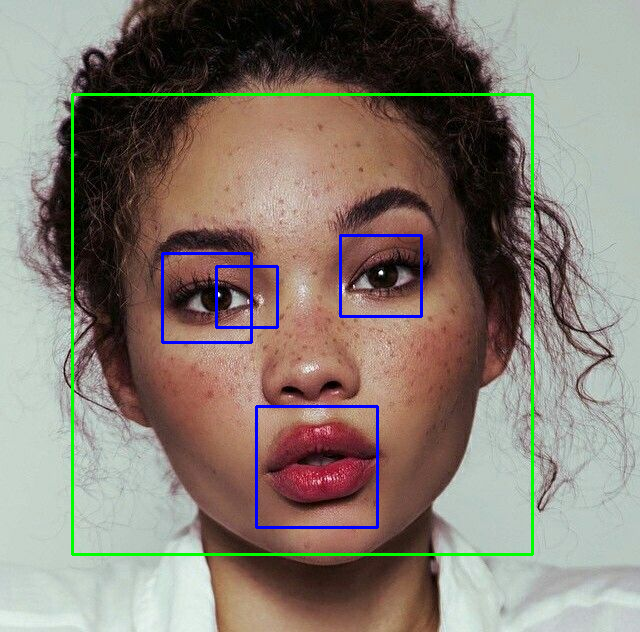

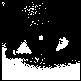

Количество строк, в которых преобладает белый цвет: 11
1


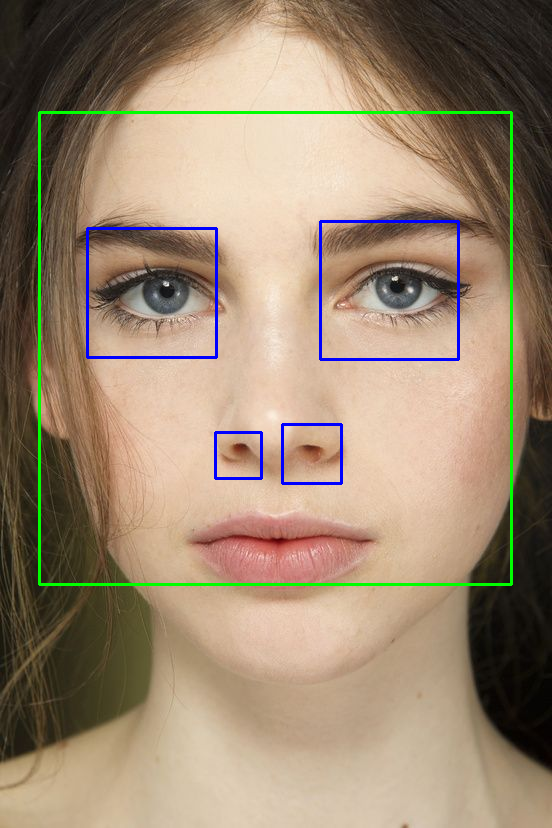

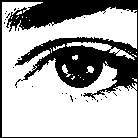

Количество строк, в которых преобладает белый цвет: 69
0


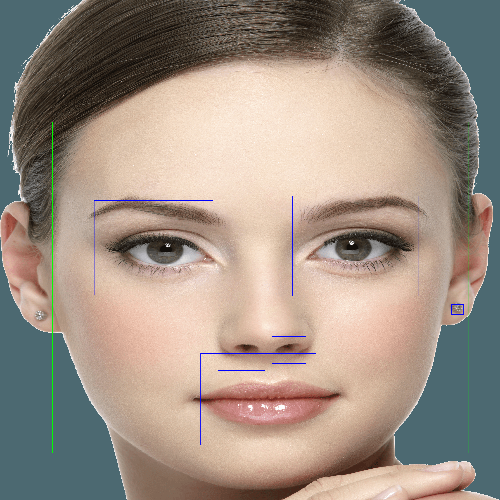

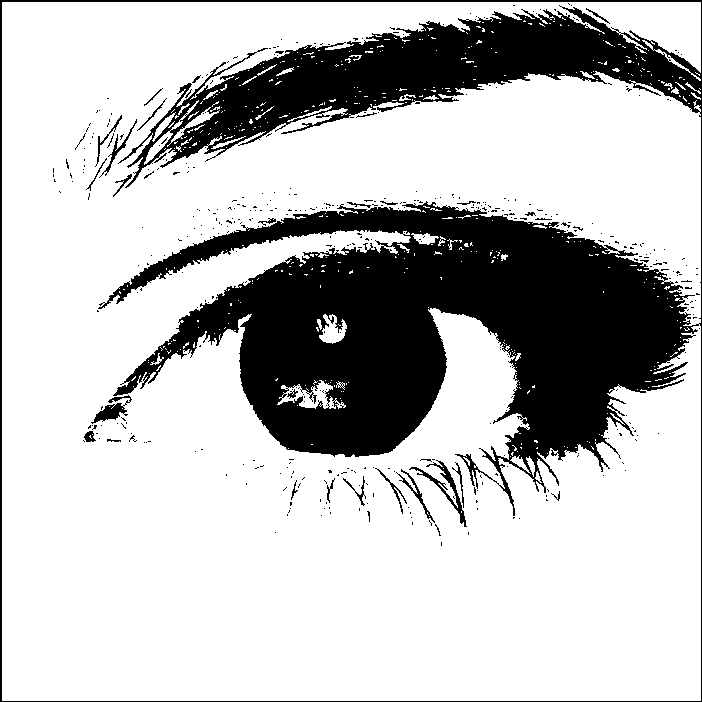

Количество строк, в которых преобладает белый цвет: 285
1


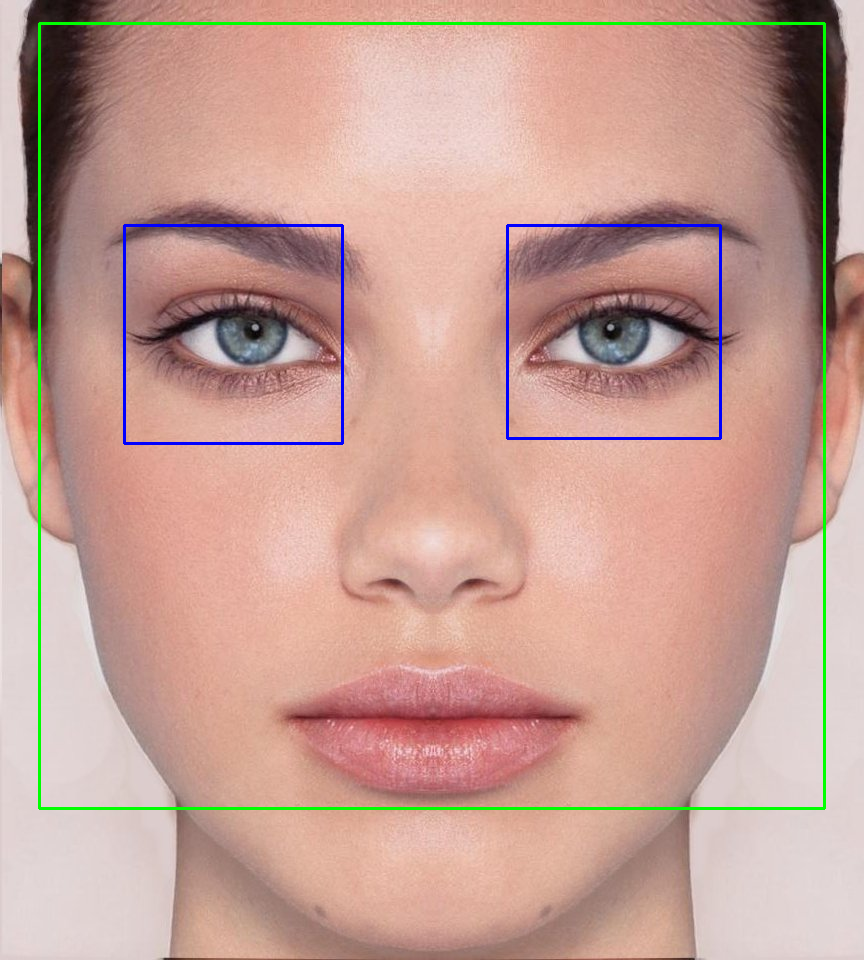

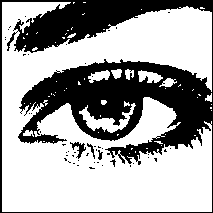

Количество строк, в которых преобладает белый цвет: 70
0


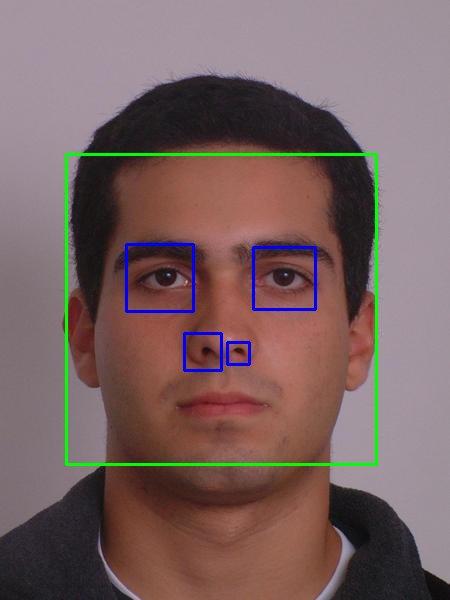

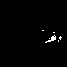

Количество строк, в которых преобладает белый цвет: 2
1


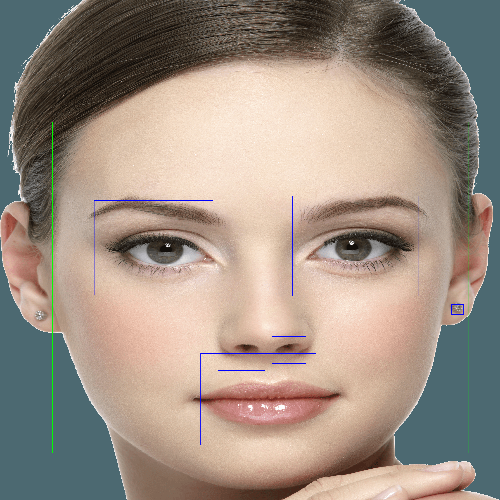

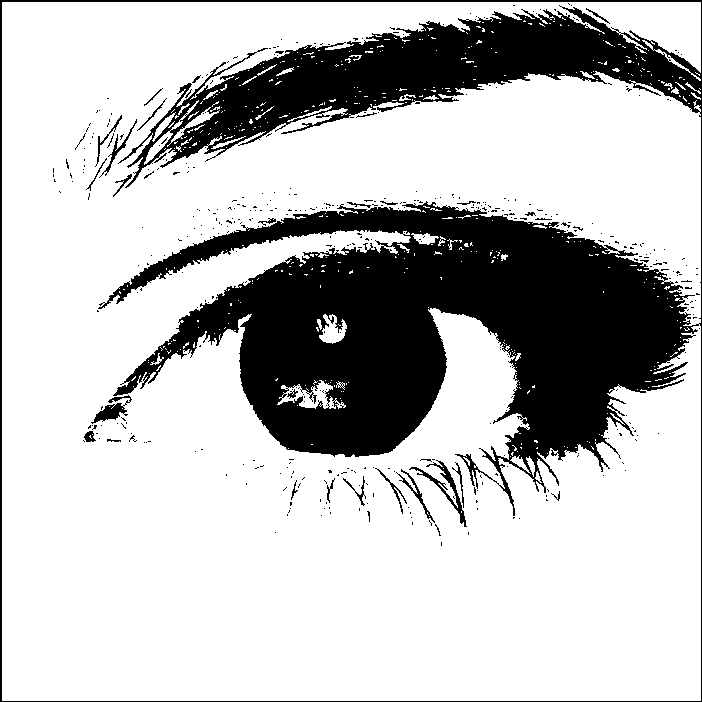

Количество строк, в которых преобладает белый цвет: 285
1


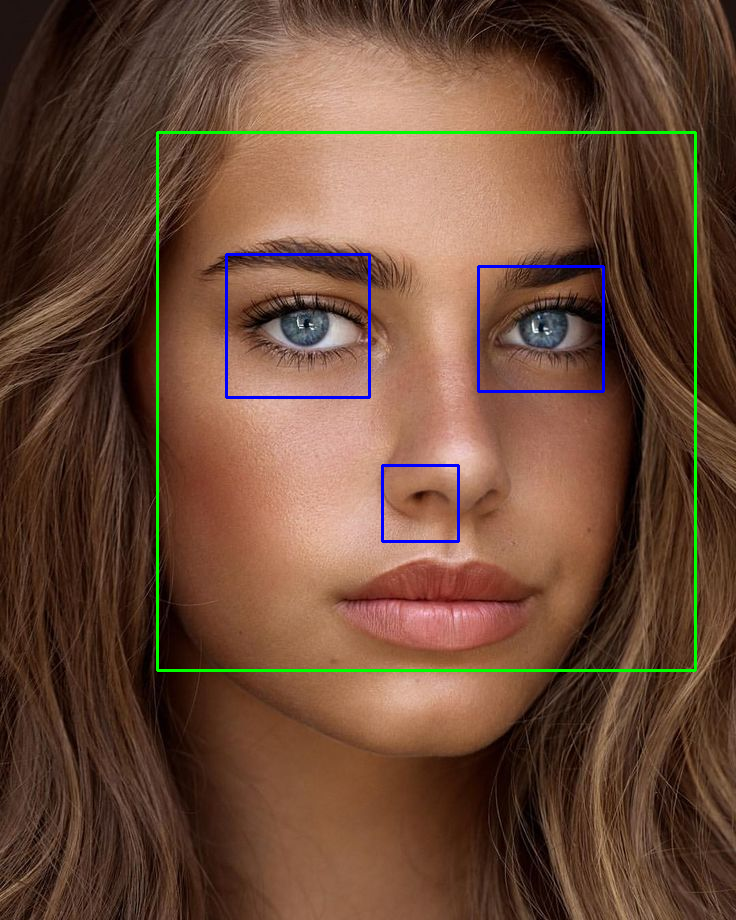

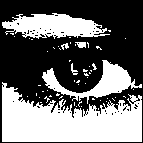

Количество строк, в которых преобладает белый цвет: 43
1


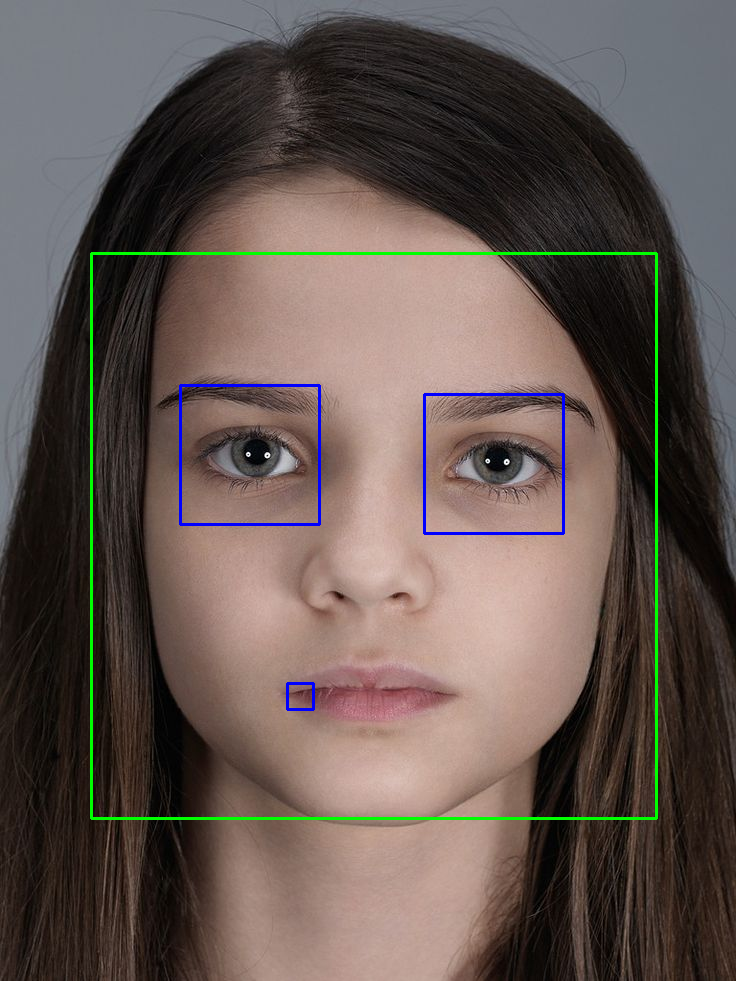

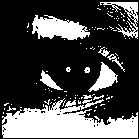

Количество строк, в которых преобладает белый цвет: 19
1


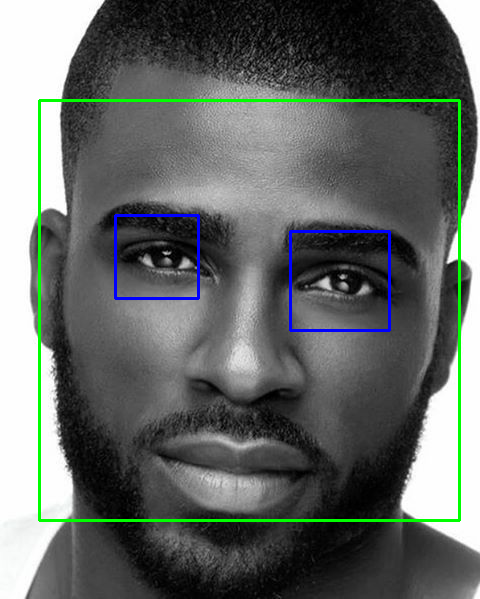

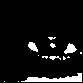

Количество строк, в которых преобладает белый цвет: 0
1


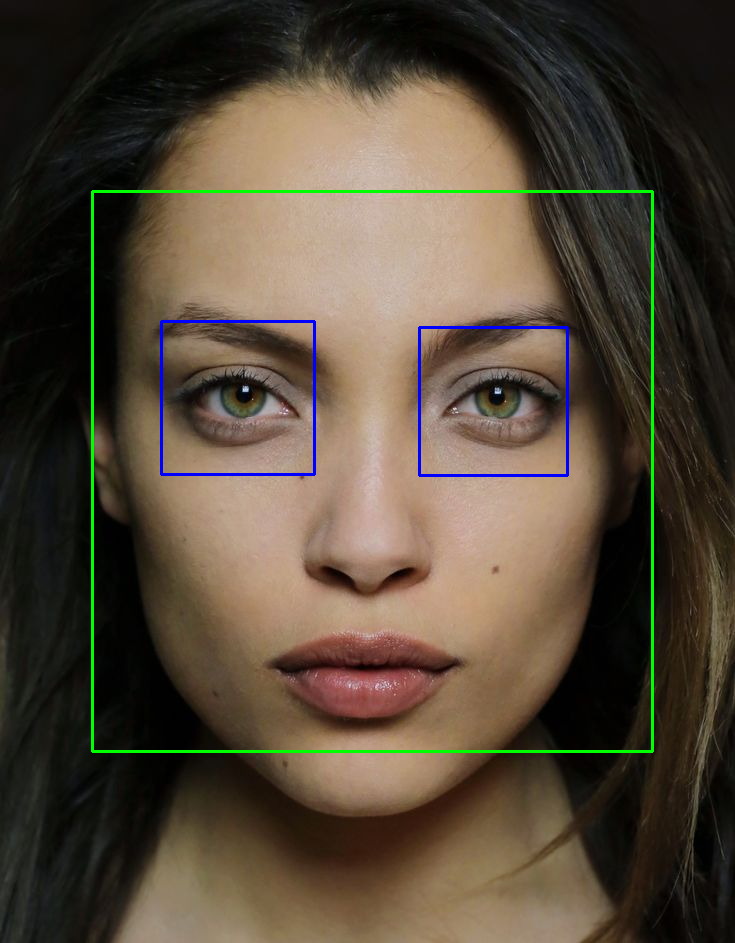

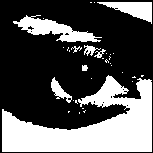

Количество строк, в которых преобладает белый цвет: 4
1
Точность модели:  83.33%.


In [ ]:
dir = '/content/asian-detect/not-asian/'
files = os.listdir(dir)

images_class = 1
image_count = len(files)
successful_predictions = 0

for file in files:
  metrics = detectFace.find_face(dir + file, show_image=True, debug=True)
  predict = clf.predict(metrics.reshape(-1, 1))
  if images_class == predict[0]:
    successful_predictions += 1
  print(predict[0])

print(f'Точность модели: {successful_predictions / image_count * 100: .2f}%.')

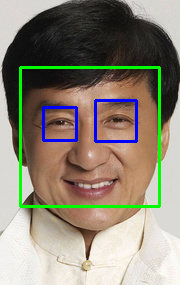

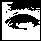

[0.]


In [ ]:
metrics = detectFace.find_face('/content/329.jpg', show_image=True, debug=True)
print(clf.predict(metrics.reshape(-1, 1)))

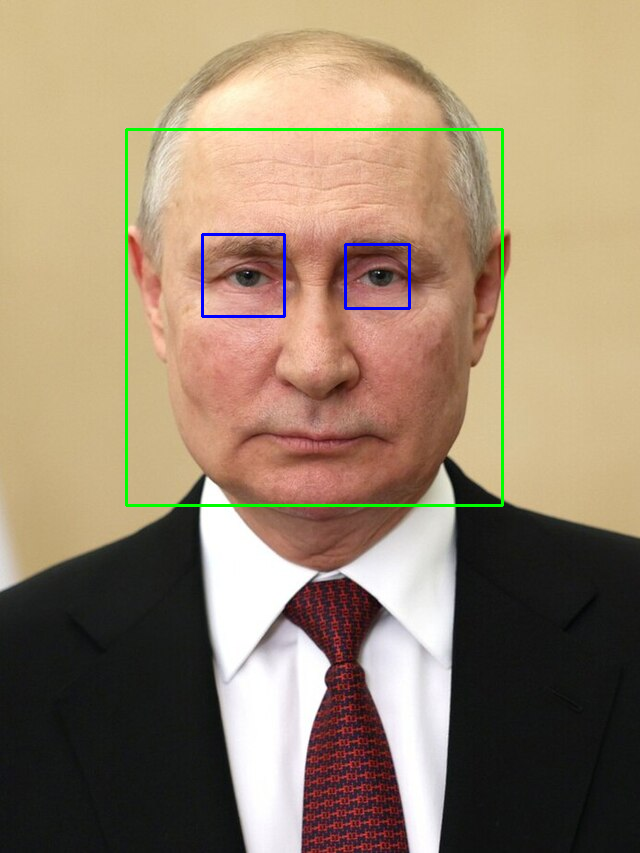

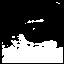

[1.]


In [ ]:
metrics = detectFace.find_face('/content/Putin.jpg', show_image=True, debug=True)
print(clf.predict(metrics.reshape(-1, 1)))